<a href="https://colab.research.google.com/github/andreyxz2000/home/blob/main/grounding_dino.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!nvidia-smi

Sat Sep  9 19:59:14 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.105.17   Driver Version: 525.105.17   CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P8     9W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [ ]:
import os

CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")
print(CONFIG_PATH, "; exist:", os.path.isfile(CONFIG_PATH))

/content/GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py ; exist: True


## Install Grounding DINO 🦕

In [ ]:
%cd {HOME}
#!git clone https://github.com/IDEA-Research/GroundingDINO.git
%cd {HOME}/GroundingDINO
!pip install -q -e .


/content
/content/GroundingDINO
  Preparing metadata (setup.py) ... done


In [ ]:
import os

CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")
print(CONFIG_PATH, "; exist:", os.path.isfile(CONFIG_PATH))

/content/GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py ; exist: True


## Download Grounding DINO Weights 🏋️

In [ ]:
%cd {HOME}
!mkdir {HOME}/weights
%cd {HOME}/weights

!wget -q https://github.com/IDEA-Research/GroundingDINO/releases/download/v0.1.0-alpha/groundingdino_swint_ogc.pth

/content
/content/weights


In [ ]:
import os

WEIGHTS_NAME = "groundingdino_swint_ogc.pth"
WEIGHTS_PATH = os.path.join(HOME, "weights", WEIGHTS_NAME)
print(WEIGHTS_PATH, "; exist:", os.path.isfile(WEIGHTS_PATH))

/content/weights/groundingdino_swint_ogc.pth ; exist: True


## Загрузка примеров фоток, на которых все изумительно работает

In [ ]:
%cd {HOME}
!mkdir {HOME}/data
%cd {HOME}/data

!wget -q https://media.roboflow.com/notebooks/examples/dog.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-2.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-3.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-4.jpeg

/content
/content/data


## Load Grounding DINO Model

In [ ]:
%cd {HOME}/GroundingDINO

from groundingdino.util.inference import load_model, load_image, predict, annotate

model = load_model(CONFIG_PATH, WEIGHTS_PATH)

/content/GroundingDINO


/usr/local/lib/python3.10/dist-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


final text_encoder_type: bert-base-uncased


## Grounding DINO Demo

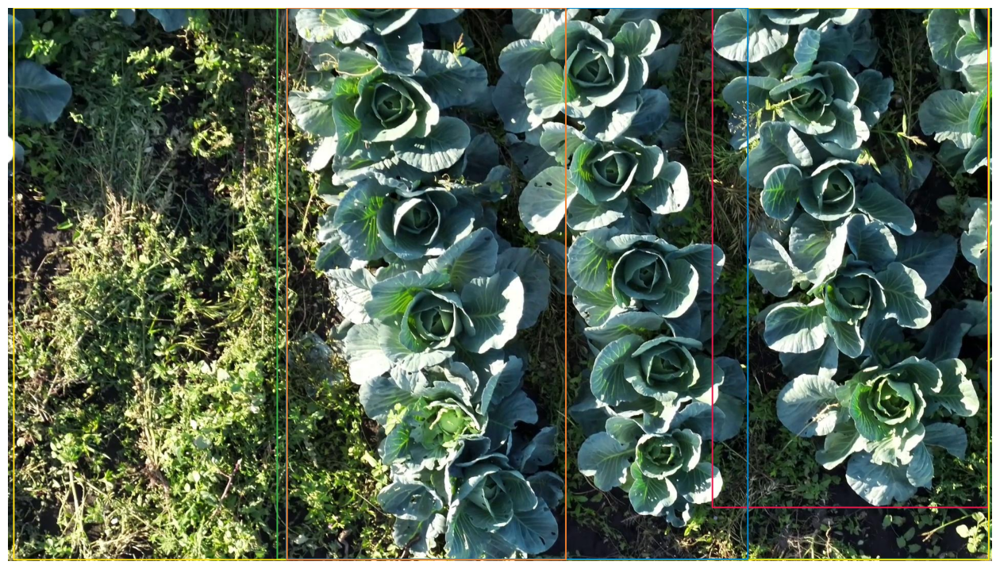

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "/content/50.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "cabbage"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

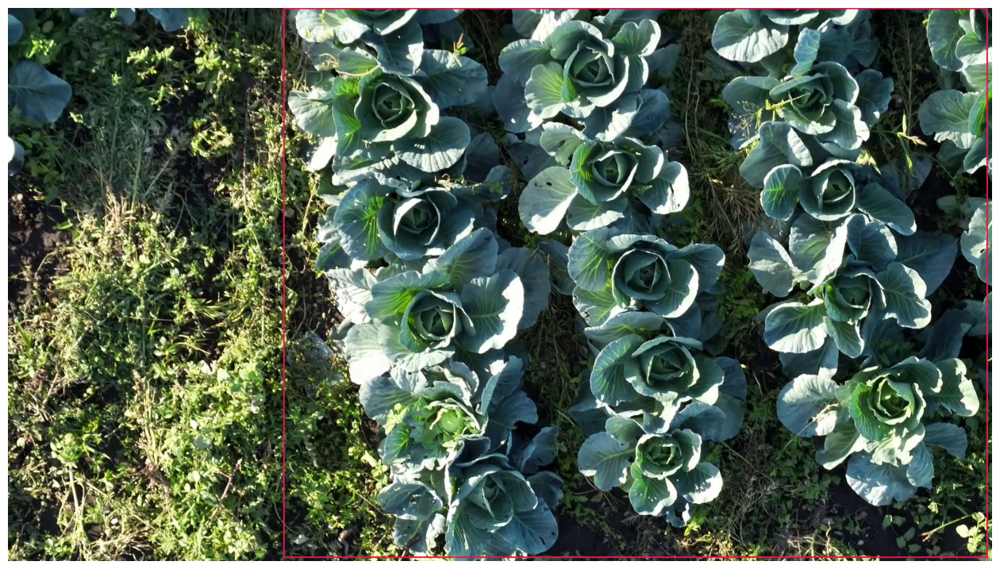

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "50.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "head of cabbage"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

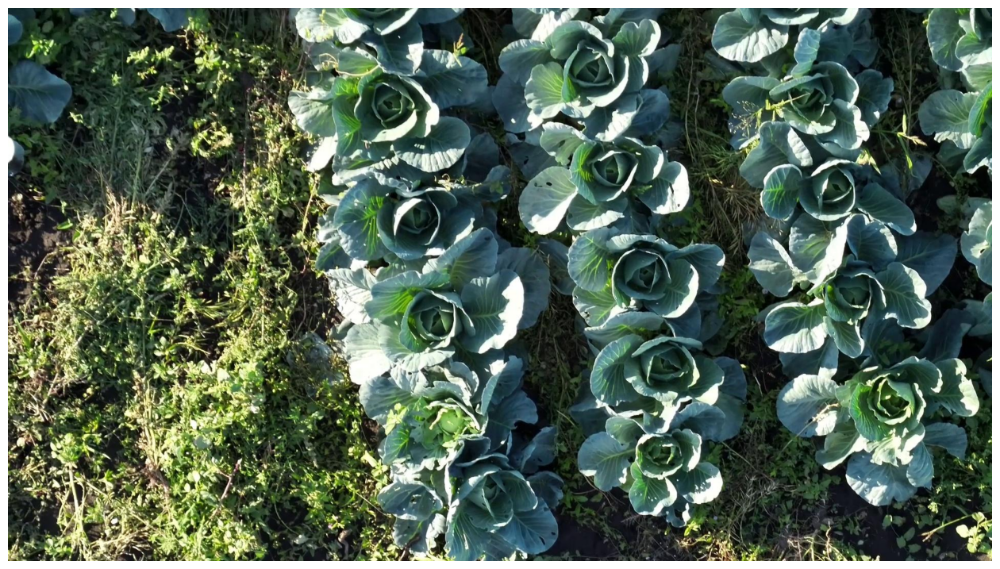

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "50.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "one head of cabbage"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

/usr/local/lib/python3.10/dist-packages/transformers/modeling_utils.py:909: FutureWarning: The `device` argument is deprecated and will be removed in v5 of Transformers.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torch/utils/checkpoint.py:31: UserWarning: None of the inputs have requires_grad=True. Gradients will be None
  warnings.warn("None of the inputs have requires_grad=True. Gradients will be None")


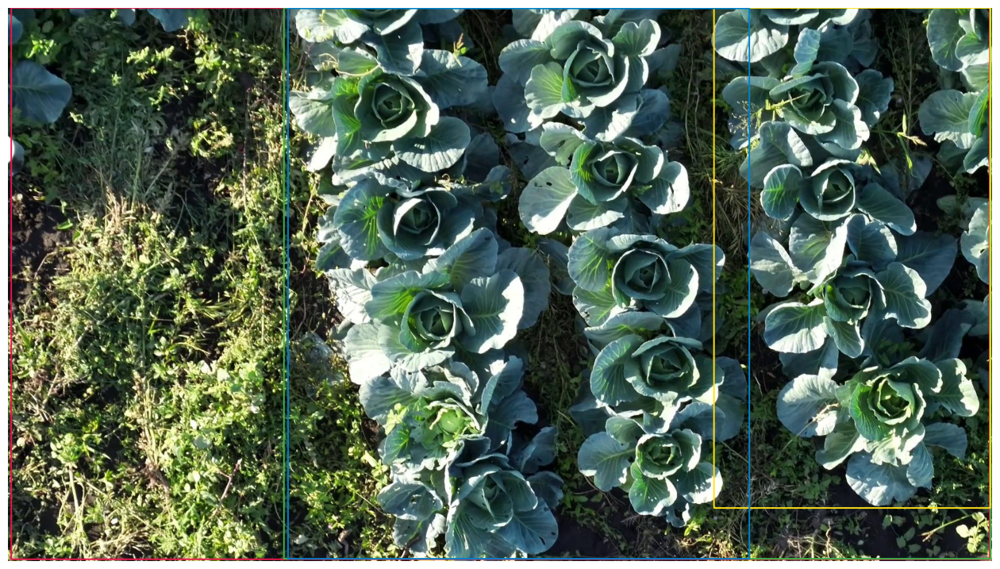

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "50.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "leaf"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

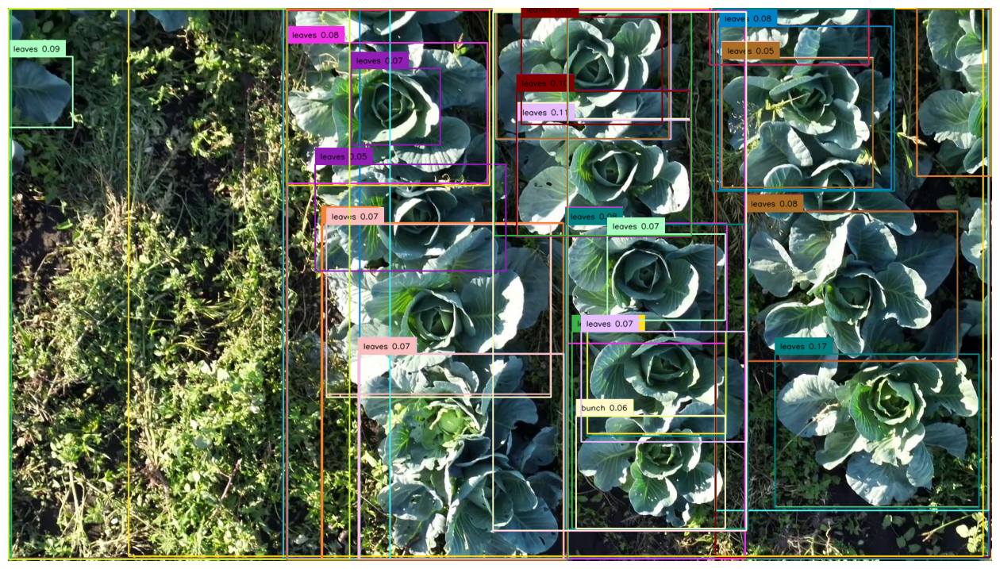

In [ ]:
IMAGE_NAME = "50.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "bunch of leaves"
BOX_TRESHOLD = 0.05
TEXT_TRESHOLD = 0.05

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

Сохранение разметки в txt

In [ ]:
# Получение абсолютного пути к файлу изображения
image_abs_path = os.path.abspath(IMAGE_PATH)

# Создание пути для сохранения файла с разметкой
annotation_file_path = os.path.splitext(image_abs_path)[0] + ".txt"

# Создание/открытие файла на запись
annotation_file = open(annotation_file_path, "w")

# Запись разметки в файл
for box, phrase in zip(boxes, phrases):
    xmin, ymin, xmax, ymax = box
    annotation_file.write(f"0 {((xmin + xmax)/2)/image.shape[1]} {((ymin + ymax)/2)/image.shape[0]} {(xmax - xmin)/image.shape[1]} {(ymax - ymin)/image.shape[0]}\n")

# Закрытие файла
annotation_file.close()

# Вывод пути к файлу с разметкой
print(f"Файл разметки сохранен по следующему пути: {annotation_file_path}")

Файл разметки сохранен по следующему пути: /content/data/dog-3.txt


## Далее примеры на собаках и прочем (что очень хорошо работает в отличии от капусты)

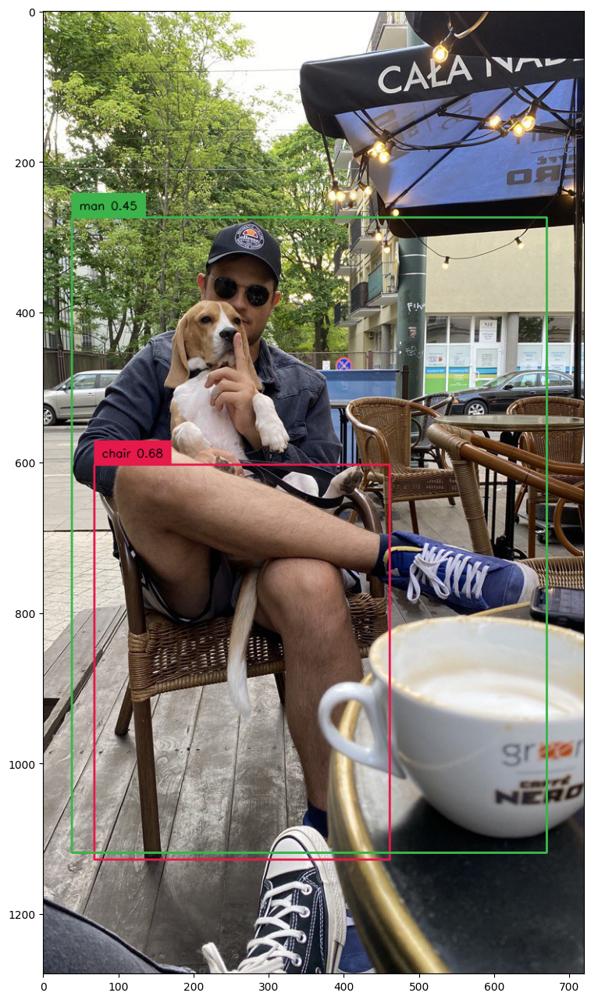

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-3.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "chair with man sitting on it"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

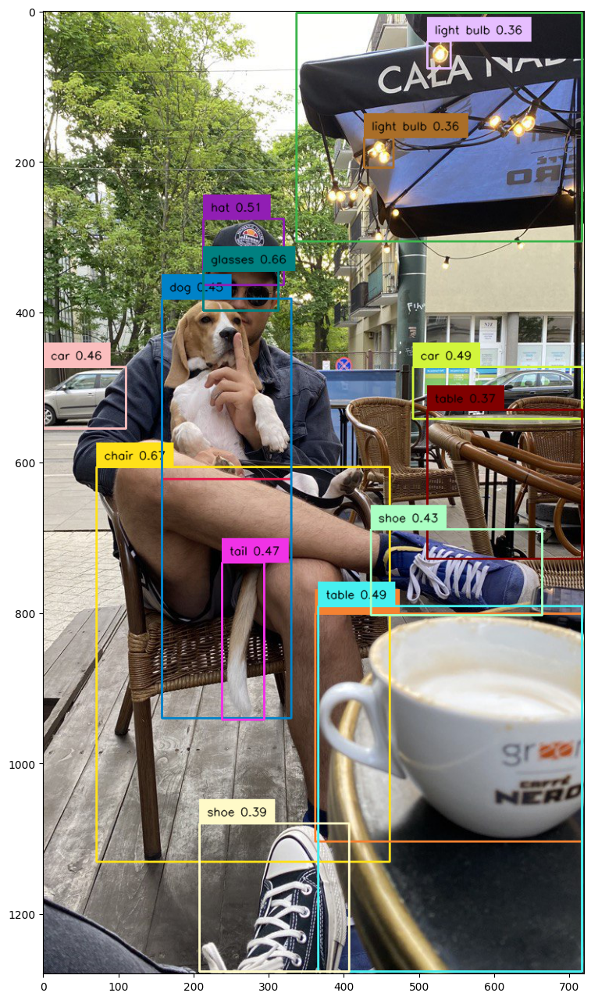

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-3.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "chair, dog, table, shoe, light bulb, coffee, hat, glasses, car, tail, umbrella"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

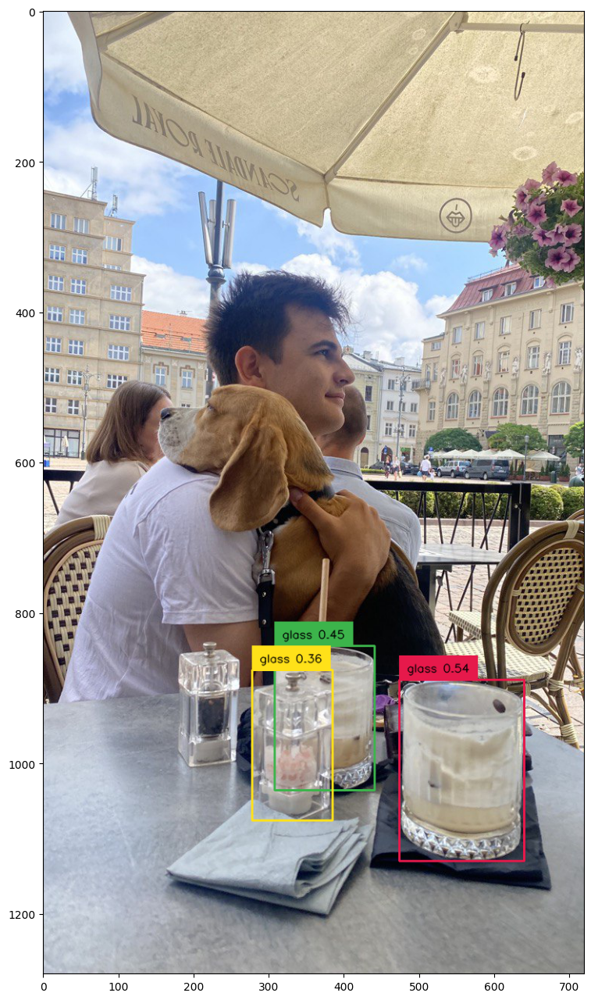

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-2.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "glass"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

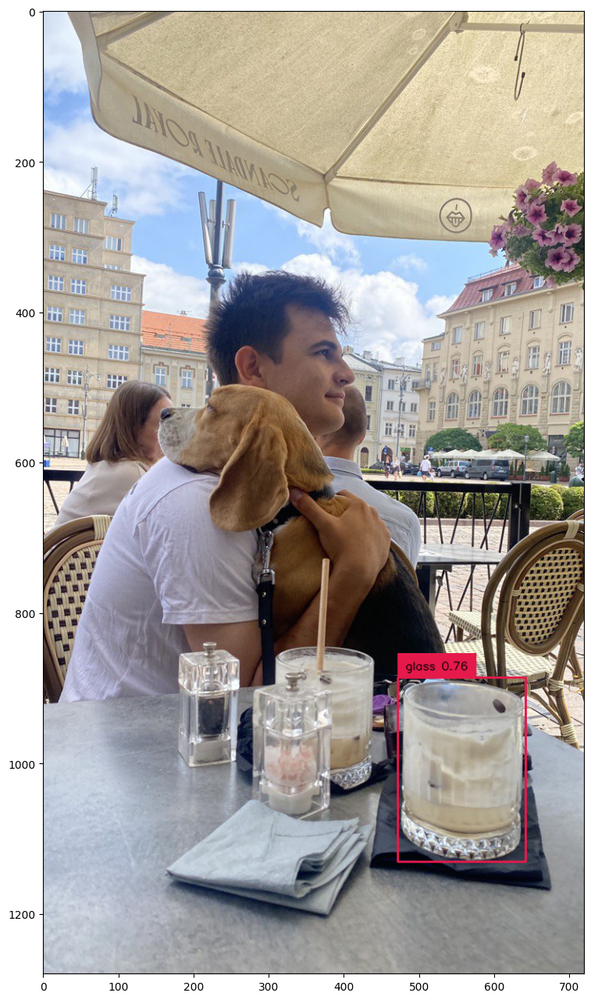

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-2.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "glass most to the right"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

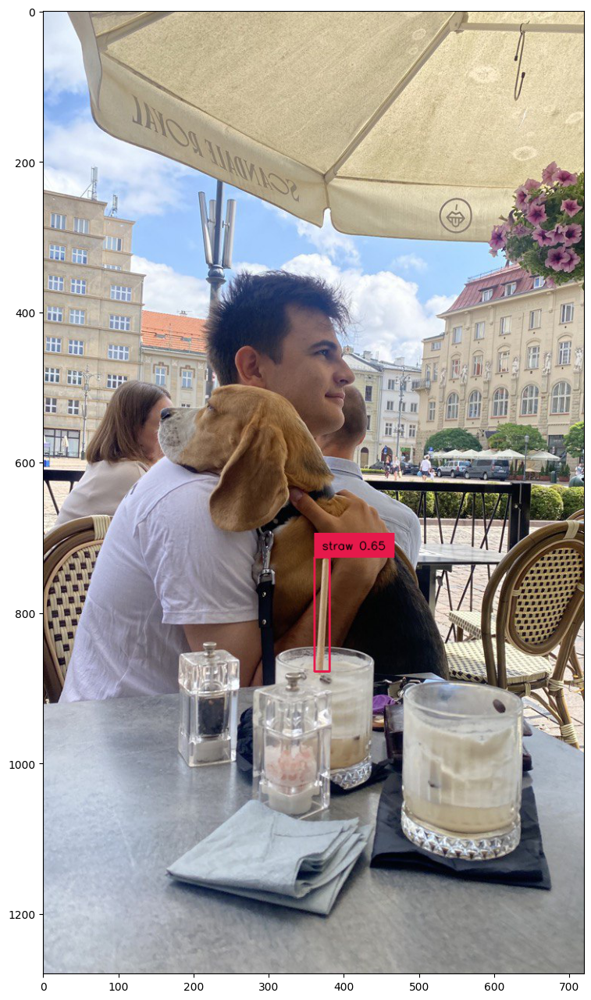

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-2.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "straw"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

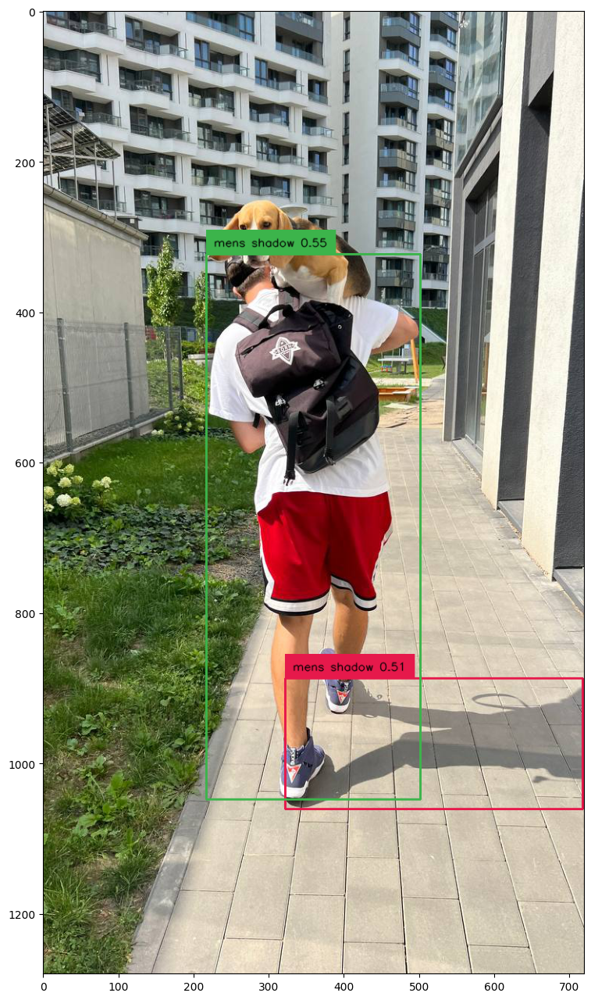

In [ ]:
import os
import supervision as sv

IMAGE_NAME = "dog-4.jpeg"
IMAGE_PATH = os.path.join(HOME, "data", IMAGE_NAME)

TEXT_PROMPT = "mens shadow"
BOX_TRESHOLD = 0.35
TEXT_TRESHOLD = 0.25

image_source, image = load_image(IMAGE_PATH)

boxes, logits, phrases = predict(
    model=model,
    image=image,
    caption=TEXT_PROMPT,
    box_threshold=BOX_TRESHOLD,
    text_threshold=TEXT_TRESHOLD
)

annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

%matplotlib inline
sv.plot_image(annotated_frame, (16, 16))

## Пытаюсь обучить сетку на моей разметке кочанов

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


безуспешно пытался подгрузить groundingdino

In [ ]:
import locale
locale.getdefaultlocale()

('en_US', 'UTF-8')

In [ ]:
!pip install --upgrade pip

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 9.9 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.1.2
    Uninstalling pip-23.1.2:
      Successfully uninstalled pip-23.1.2


In [ ]:
import os

# Установить переменную окружения LC_ALL в UTF-8
os.environ['LC_ALL'] = 'en_US.UTF-8'

# Установить groundingdino
!pip install groundingdino


ERROR: Could not find a version that satisfies the requirement groundingdino (from versions: none)
ERROR: No matching distribution found for groundingdino


In [ ]:
import os
import torch
from torchvision.datasets import DatasetFolder
from torch.utils.data import DataLoader
from groundingdino.data.datasets import GroundingDataset
from torch.optim import Adam
from groundingdino.util.training import train_model
from groundingdino.config import DefaultConfig

# Укажите путь к папке с изображениями
data_folder = "/content/drive/MyDrive/Учебные БД/data_2/train/images"

# Укажите путь к папке с разметкой в формате txt
annotation_folder = "/content/drive/MyDrive/Учебные БД/data_2/train/labels"

# Параметры обучения
batch_size = 8
epochs = 10
learning_rate = 0.001

# Создайте загрузчик данных
dataset = GroundingDataset(data_folder, annotation_folder)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Создайте модель GroundingDINO
model = GroundingDINO()

# Создайте оптимизатор
optimizer = Adam(model.parameters(), lr=learning_rate)

# Обучение модели
train_model(model, dataloader, optimizer, epochs)

# Сохранение обученной модели
output_folder = "/content/drive/MyDrive/Учебные БД/data_store"
os.makedirs(output_folder, exist_ok=True)
model_path = os.path.join(output_folder, "groundingdino_model.pth")
torch.save(model.state_dict(), model_path)

ModuleNotFoundError: ignored

GPT 3.5 порекомендовал сделать правки но не помогло:

In [ ]:
import os
import torch
from torch.optim import Adam
from torch.utils.data import DataLoader
from torchvision.datasets import DatasetFolder
from groundingdino.data.datasets import GroundingDataset
from groundingdino.models import GroundingDINO  # Импортировать класс GroundingDINO из groundingdino.models
from groundingdino.util.training import train_model
from groundingdino.config import DefaultConfig

# Укажите путь к папке с изображениями
data_folder = "/content/drive/MyDrive/Учебные БД/data_2/train/images"

# Укажите путь к папке с разметкой в формате txt
annotation_folder = "/content/drive/MyDrive/Учебные БД/data_2/train/labels"

# Параметры обучения
batch_size = 8
epochs = 10
learning_rate = 0.001

# Создайте загрузчик данных
dataset = GroundingDataset(data_folder, annotation_folder)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Создайте модель GroundingDINO
model = GroundingDINO()  # Создать экземпляр модели GroundingDINO

# Создайте оптимизатор
optimizer = Adam(model.parameters(), lr=learning_rate)

# Обучение модели
train_model(model, dataloader, optimizer, epochs)

# Сохранение обученной модели
output_folder = "/content/drive/MyDrive/Учебные БД/data_store"
os.makedirs(output_folder, exist_ok=True)
model_path = os.path.join(output_folder, "groundingdino_model.pth")
torch.save(model.state_dict(), model_path)


ModuleNotFoundError: ignored

In [ ]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [ ]:
%cd {HOME}
!git clone https://github.com/IDEA-Research/GroundingDINO.git
%cd {HOME}/GroundingDINO
!pip install -q -e .
!pip install -q roboflow

/content
Cloning into 'GroundingDINO'...
remote: Enumerating objects: 401, done.
remote: Counting objects: 100% (85/85), done.
remote: Compressing objects: 100% (35/35), done.
remote: Total 401 (delta 58), reused 50 (delta 50), pack-reused 316
Receiving objects: 100% (401/401), 12.85 MiB | 30.25 MiB/s, done.
Resolving deltas: 100% (204/204), done.
/content/GroundingDINO
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 119.9/119.9 kB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 39.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 33.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 250.3/250.3 kB 14.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.8/268.8 kB 31.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
import os

CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")
print(CONFIG_PATH, "; exist:", os.path.isfile(CONFIG_PATH))

/content/GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py ; exist: True


In [ ]:
# Установка groundingdino
!pip install groundingdino

import os
import torch
from torchvision.datasets import DatasetFolder
from torch.utils.data import DataLoader
from groundingdino.models import GroundingDINO
from torch.optim import Adam
#from groundingdino.util.training import train_model

# Укажите путь к папке с изображениями
data_folder = "/content/drive/MyDrive/Учебные БД/data_2/train/images"

# Укажите путь к папке с разметкой в формате txt
annotation_folder = "/content/drive/MyDrive/Учебные БД/data_2/train/labels"

# Параметры обучения
batch_size = 8
epochs = 10
learning_rate = 0.001

#

In [ ]:
# Укажите путь к папке с изображениями
data_folder = "/content/drive/MyDrive/Учебные БД/data_2/train/images"

# Укажите путь к папке с разметкой в формате txt
annotation_folder = "/content/drive/MyDrive/Учебные БД/data_2/train/labels"

# Параметры обучения
batch_size = 8
epochs = 10
learning_rate = 0.001

# Создайте загрузчик данных
dataset = GroundingDataset(data_folder, annotation_folder)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

# Создайте модель GroundingDINO
model = GroundingDINO()

# Создайте оптимизатор
optimizer = Adam(model.parameters(), lr=learning_rate)

# Обучение модели
train_model(model, dataloader, optimizer, epochs)

# Сохранение обученной модели
output_folder = "/content/drive/MyDrive/Учебные БД/data_store"
os.makedirs(output_folder, exist_ok=True)
model_path = os.path.join(output_folder, "groundingdino_model.pth")
torch.save(model.state_dict(), model_path)

NameError: ignored

Тестируем https://colab.research.google.com/drive/14qgA9IUYCVAALJmJabvQ9sDxrKxEezwP?usp=sharing#scrollTo=L6W0-XKwXSGu

In [ ]:
!pip install auto-annotate==1.0.5

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive/')

Drive already mounted at /content/gdrive/; to attempt to forcibly remount, call drive.mount("/content/gdrive/", force_remount=True).


In [ ]:
#создание label_map.pbtxt с классом 0: bad

def generate_label_map(label_map):
    pbtxt = ''
    for label_name, label_id in label_map.items():
        pbtxt += "item {\n"
        pbtxt += "  id: {}\n".format(label_id)
        pbtxt += "  name: '{}'\n".format(label_name)
        pbtxt += "}\n\n"

    with open('label_map.pbtxt', 'w') as f:
        f.write(pbtxt)

# Define your class labels and their corresponding numeric values
label_map = {'bad': 0}

# Generate the label_map.pbtxt file
generate_label_map(label_map)

In [ ]:
from auto_annotate import AutoAnnotate

ann_tool = AutoAnnotate(
              saved_model_path = '/content/gdrive/MyDrive/Учебные БД/data_2/saved_model.pb',
              label_map_path = '/content/label_map.pbtxt',
              images_path = '/content/gdrive/MyDrive/Учебные БД/data_2/train/images',
              xml_path = '/content/gdrive/MyDrive/Учебные БД/data_2/train/images',
              detection_threshold = 0.5)

ann_tool.generate_annotations()

Loading model into memory...
Error loading model: SavedModel file does not exist at: /content/gdrive/MyDrive/Учебные БД/data_2/saved_model.pb/{saved_model.pbtxt|saved_model.pb}


OSError: ignored

In [ ]:
# как преобразовать модель yolo
import tensorflow as tf

# Загрузите обученную модель YOLO
yolo_model = tf.keras.models.load_model('path_to_yolo_model.h5')

# Сохраните модель в формат SavedModel
tf.saved_model.save(yolo_model, 'path_to_saved_model_directory')
